In [1]:
# load required package
import numpy as np
import os
import cv2

from matplotlib import pyplot as plt

import tensorflow as tf
from keras import backend as K

from tqdm import tqdm
from functools import partial
tqdm = partial(tqdm, position=0, leave=True)

In [2]:
# load self-defined functions
!cp /content/drive/MyDrive/Colab\ Notebooks/codes/modules/data_generator.py /content
!cp /content/drive/MyDrive/Colab\ Notebooks/codes/modules/dice.py /content
!cp /content/drive/MyDrive/Colab\ Notebooks/codes/modules/f1_score.py /content
!cp /content/drive/MyDrive/Colab\ Notebooks/codes/modules/misc.py /content

from data_generator import binarize_mask, data_generator
from dice import dice_coef, dice_coef_loss
from f1_score import F1_score
from misc import convert_to_bw, plot_test_pred

In [3]:
# define paths of the training, validation, and test sets
train_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_image/train/images/'
mask_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_mask/train/masks_xbuffer/'
 
val_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_image/val/images/'
v_mask_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_mask/val/masks_xbuffer/'

test_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_image/test/images/'
t_mask_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_mask/test/masks_xbuffer/'

In [4]:
# define the desired shape of images and their masks for training
# using (512, 512) but not (1024, 1024) because (1024, 1024) will lead to out-of-memory error when training the data
image_shape = (512, 512)

In [5]:
# The following codes are adpoted and modified based on
# https://github.com/nikhilroxtomar/Semantic-Segmentation-Architecture/blob/main/TensorFlow/resnet50_unet.py

# define the encoding path of a U-Net architecture
def conv_block(input, num_filters, kernel_size=(3,3)):
  x = tf.keras.layers.Conv2D(num_filters, kernel_size, padding="same")(input)
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.Activation("relu")(x)
  
  x = tf.keras.layers.Conv2D(num_filters, kernel_size, padding="same")(x)
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.Activation("relu")(x)
  
  return x

# define the decoding path of a U-Net architecture
def decoder_block(input, s, num_filters, kernel_size=(2,2)):
  x = tf.keras.layers.Conv2DTranspose(num_filters, kernel_size, strides=2, padding="same")(input)
  x = tf.keras.layers.Concatenate()([x,s])
  x = conv_block(x, num_filters)
  
  return x

# define a U-Net using the ResNet50 pretrained on imagenet for the encoding path
def ResNet50_UNet(image_shape, num_filters):
  inputs = tf.keras.layers.Input(image_shape)
  
  ResNet50 = tf.keras.applications.ResNet50(include_top = False, weights = 'imagenet', input_tensor = inputs)

  # layer with matching output shape is selected
  s1 = ResNet50.get_layer('input_1').output           
  s2 = ResNet50.get_layer('conv1_relu').output        
  s3 = ResNet50.get_layer('conv2_block3_out').output  
  s4 = ResNet50.get_layer('conv3_block4_out').output  

  # the bridge of the U-Net architecture
  bn = ResNet50.get_layer('conv4_block6_out').output
  
  d1 = decoder_block(bn, s4, num_filters[0])
  d2 = decoder_block(d1, s3, num_filters[1])
  d3 = decoder_block(d2, s2, num_filters[2])
  d4 = decoder_block(d3, s1, num_filters[3])

  outputs = tf.keras.layers.Conv2D(1, (3, 3), padding="same", activation="sigmoid")(d4)
  model = tf.keras.models.Model(inputs, outputs)
  # the learning rate is set to 0.0001
  adam = tf.keras.optimizers.Adam(learning_rate=0.0001)
  # compile the model with dice loss
  model.compile(optimizer=adam,
                loss=dice_coef_loss,
                metrics=[dice_coef])
  
  return model

In [6]:
# the input of training data is (512, 512) with RGB channels
shape = (512, 512, 3)

# the number of filters in each block
num_filters = [512, 256, 128, 64]

# get the summary of the model
model = ResNet50_UNet(shape, num_filters)
model.summary()

94781440/94765736 [==============================] - 1s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 518, 518, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 256, 256, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                             

In [ ]:
# feed the model with 2 images and their masks for preventing out-of-memory error
batch_size = 2

# the steps in each epoch will be the number of total images divided by the batch size
n_step = len(os.listdir(train_dir)) // batch_size

# fit the model
history = model.fit(data_generator(train_dir, mask_dir, batch_size, image_shape),
                    steps_per_epoch = n_step,
                    epochs = 12,
                    verbose = 1,
                    validation_data = data_generator(val_dir, v_mask_dir, batch_size, image_shape),
                    validation_steps = 1)

Epoch 1/12


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  # This is added back by InteractiveShellApp.init_path()


539/539 [==============================] - 404s 734ms/step - loss: 0.4991 - dice_coef: 0.5009 - val_loss: 0.9987 - val_dice_coef: 0.0013
Epoch 2/12
539/539 [==============================] - 114s 212ms/step - loss: 0.3954 - dice_coef: 0.6046 - val_loss: 0.3370 - val_dice_coef: 0.6630
Epoch 3/12
539/539 [==============================] - 115s 213ms/step - loss: 0.3564 - dice_coef: 0.6436 - val_loss: 0.3834 - val_dice_coef: 0.6166
Epoch 4/12
539/539 [==============================] - 115s 213ms/step - loss: 0.3338 - dice_coef: 0.6662 - val_loss: 0.2956 - val_dice_coef: 0.7044
Epoch 5/12
539/539 [==============================] - 115s 212ms/step - loss: 0.3067 - dice_coef: 0.6933 - val_loss: 0.4437 - val_dice_coef: 0.5563
Epoch 6/12
539/539 [==============================] - 115s 213ms/step - loss: 0.2857 - dice_coef: 0.7143 - val_loss: 0.2999 - val_dice_coef: 0.7001
Epoch 7/12
539/539 [==============================] - 114s 212ms/step - loss: 0.2759 - dice_coef: 0.7241 - val_loss: 0.6322

In [ ]:
# save the trained model
# model.save('/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/models_saved/0421_ResNetUNet_A')

INFO:tensorflow:Assets written to: /content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/DigitalSreeniExample/models_saved/0421_ResNetUNet_A/assets


In [7]:
# load the model from the saved file
model = tf.keras.models.load_model('/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/models_saved/0421_ResNetUNet_A', custom_objects={"dice_coef_loss": dice_coef_loss, "dice_coef": dice_coef})

In [8]:
# derive predictions on the test set
batch_size = 1
n_step = len(os.listdir(test_dir)) // batch_size
pred = model.predict(data_generator(test_dir, t_mask_dir, batch_size, image_shape), verbose = 1, steps = n_step)

61/61 [==============================] - 68s 966ms/step


In [9]:
# import test images from the test set folder
filename_list = os.listdir(test_dir)
image_list = []
for filename in filename_list:
  img = cv2.imread(test_dir + filename)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  image_list.append(cv2.resize(img, image_shape, interpolation=cv2.INTER_AREA))

In [10]:
# get the suffix of image file name
img_id = []
for filename in filename_list:
  img_id.append(filename.split('_')[7][:-4])

# create a list of the test masks in the order of test images by matching file name suffix
front = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_mask/test/masks_xbuffer/AOI_4_Shanghai_geojson_roads_'
mask_filename_list = [(front + x + '.png') for x in img_id]

# import test masks from the test set folder
mask_list = []
for filename in mask_filename_list:
  mask = cv2.imread(filename)
  mask_list.append(cv2.resize(mask, image_shape, interpolation=cv2.INTER_AREA))

In [11]:
# convert the predictions to black and white images
pred = convert_to_bw(pred, test_num = 61)

100%|██████████| 61/61 [00:33<00:00,  1.81it/s]


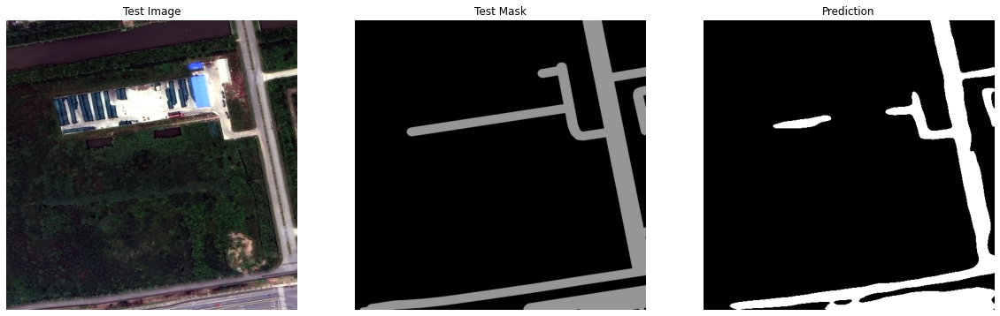

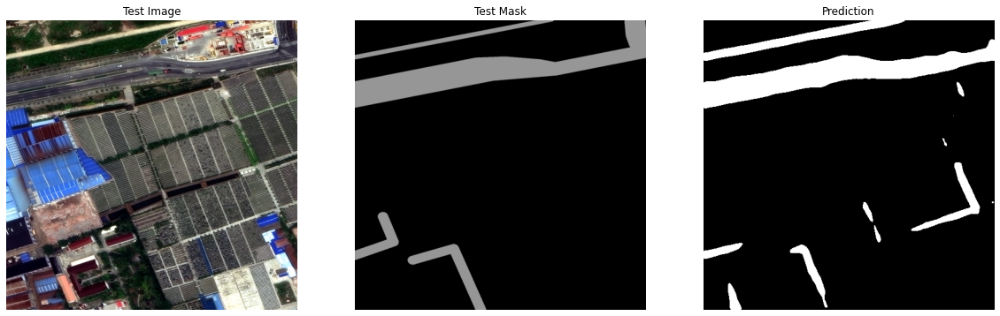

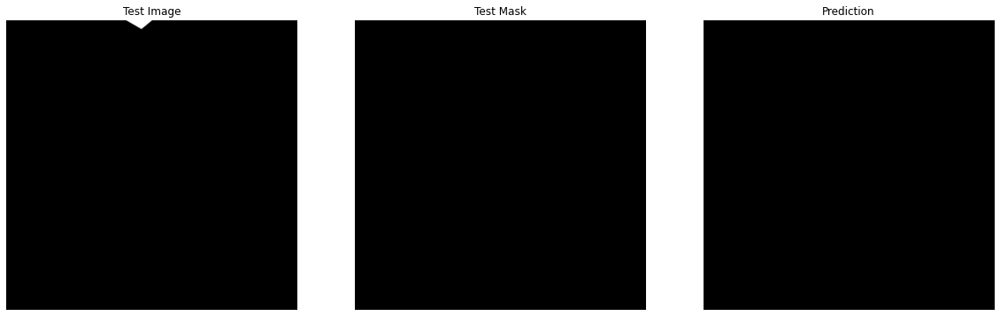

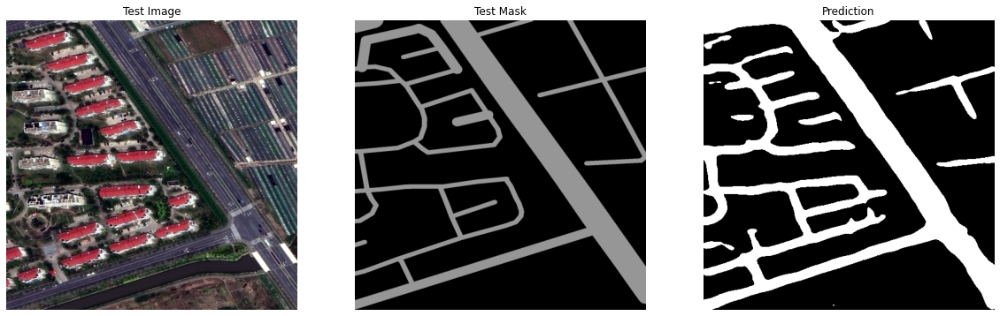

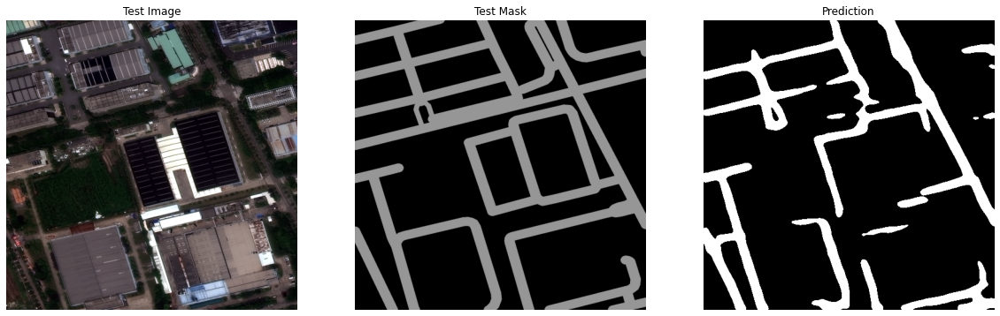

...

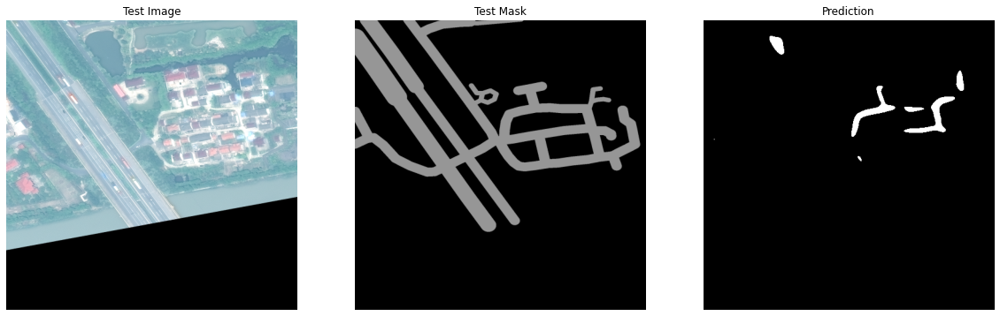

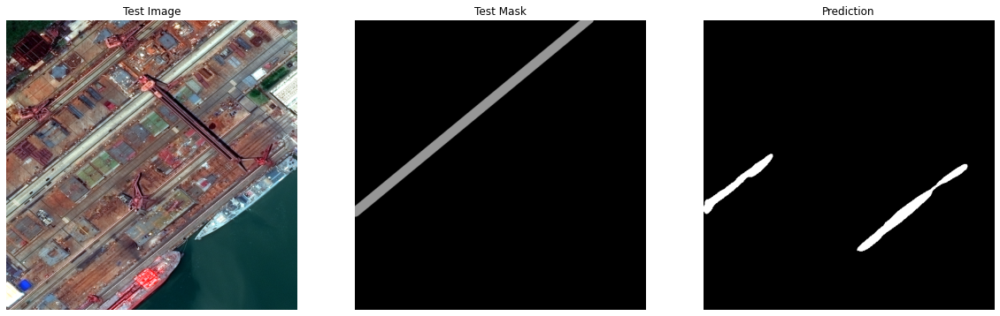

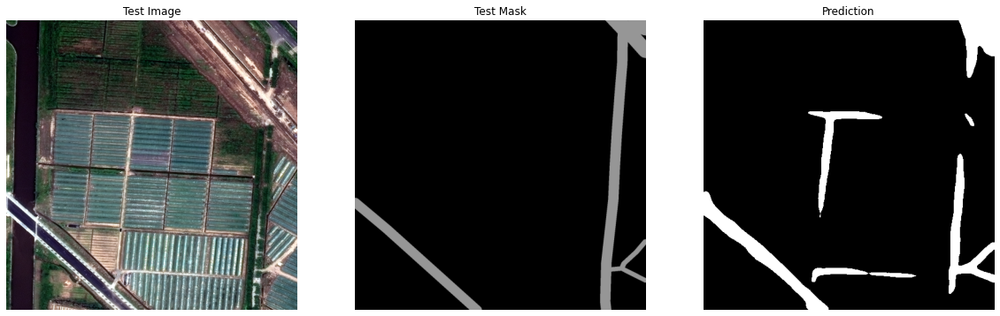

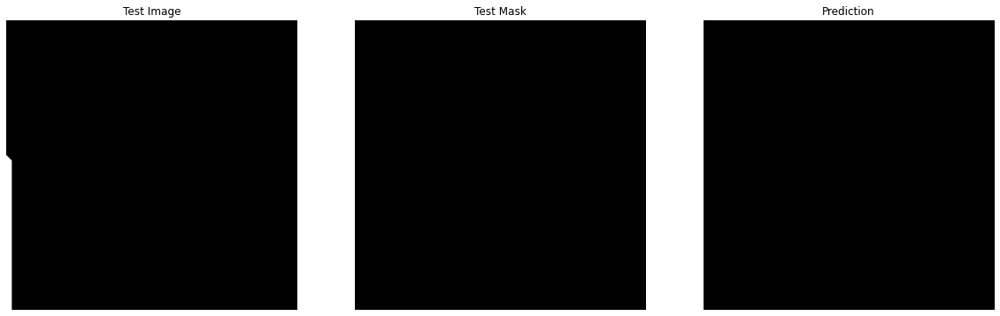

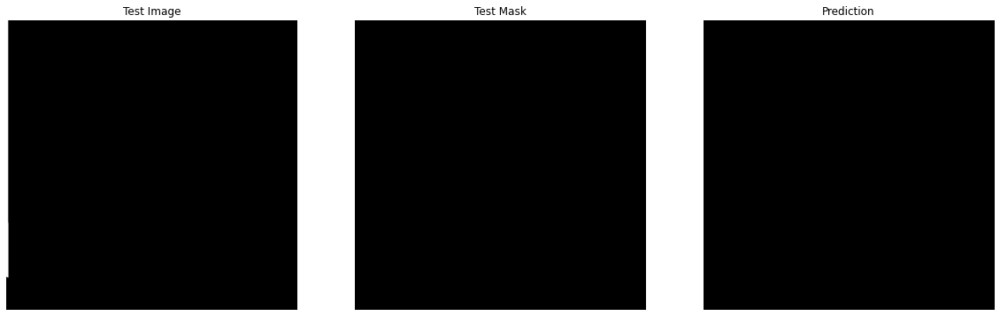

In [12]:
plot_test_pred(image_list, mask_list, pred, test_num = 61)

In [13]:
F1_score(mask_list, pred)

0.6569259589813439